In [1]:
# # This Python 3 environment comes with many helpful analytics libraries installed
# # It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# # For example, here's several helpful packages to load

# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# # Input data files are available in the read-only "../input/" directory
# # For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

# # You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# # You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

ЛАБА 4.

нужно сделать/найти датасет изображений  и обучить/дообучить модель на нем

In [2]:
# Установка ultralytics
!pip install ultralytics --quiet

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 993.8/993.8 kB 16.7 MB/s eta 0:00:00a 0:00:01


In [3]:
# Блок 1: Работа с данными через Kaggle
import kagglehub
import os
import shutil

# Download latest version
path = kagglehub.dataset_download("samuelcortinhas/muffin-vs-chihuahua-image-classification")
print("Path to dataset files:", path)

def setup_kaggle_dataset():
    # Пути к данным в Kaggle
    dataset_dir = '/kaggle/input/muffin-vs-chihuahua-image-classification'    
    
    print(f"Данные: {dataset_dir}")

    return dataset_dir

# Получение путей к данным
source_dir = setup_kaggle_dataset()

# Целевая папка (куда копируем)
dataset_dir = '/kaggle/working/dataset'

# Копируем все содержимое исходной папки в рабочую область
shutil.copytree(source_dir, dataset_dir)

print(f"Данные скопированы в: {dataset_dir}")

Path to dataset files: /kaggle/input/muffin-vs-chihuahua-image-classification
Данные: /kaggle/input/muffin-vs-chihuahua-image-classification
Данные скопированы в: /kaggle/working/dataset


In [4]:
# # Выведем список файлов в рабочей папке
# print("Файлы в рабочей директории:")
# for root, dirs, files in os.walk(target_dir):
#     for file in files:
#         print(os.path.join(root, file))

In [5]:
# Блок 2: Подготовка данных и создание аннотаций YOLO
import cv2
import numpy as np
from pathlib import Path

def create_yolo_annotations(dataset_dir):
    for split in ['train', 'test']:
        for class_name in ['chihuahua', 'muffin']:
            class_dir = Path(dataset_dir) / split / class_name
            class_id = 0 if class_name == 'chihuahua' else 1

            for img_path in class_dir.glob('*.jpg'):
                # Чтение изображения
                img = cv2.imread(str(img_path))
                h, w = img.shape[:2]

                # Создаем маску объекта (упрощенный пример)
                gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
                _, mask = cv2.threshold(gray, 200, 255, cv2.THRESH_BINARY_INV)

                # Находим контуры
                contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
                if contours:
                    # Берем самый большой контур
                    cnt = max(contours, key=cv2.contourArea)
                    x, y, w_bbox, h_bbox = cv2.boundingRect(cnt)

                    # Нормализованные координаты YOLO
                    xc = (x + w_bbox/2) / w
                    yc = (y + h_bbox/2) / h
                    w_norm = w_bbox / w
                    h_norm = h_bbox / h

                    # Сохраняем аннотацию
                    txt_path = (class_dir / img_path.stem).with_suffix('.txt')
                    with open(txt_path, 'w') as f:
                        f.write(f"{class_id} {xc} {yc} {w_norm} {h_norm}")

# Создаем аннотации
create_yolo_annotations(dataset_dir)

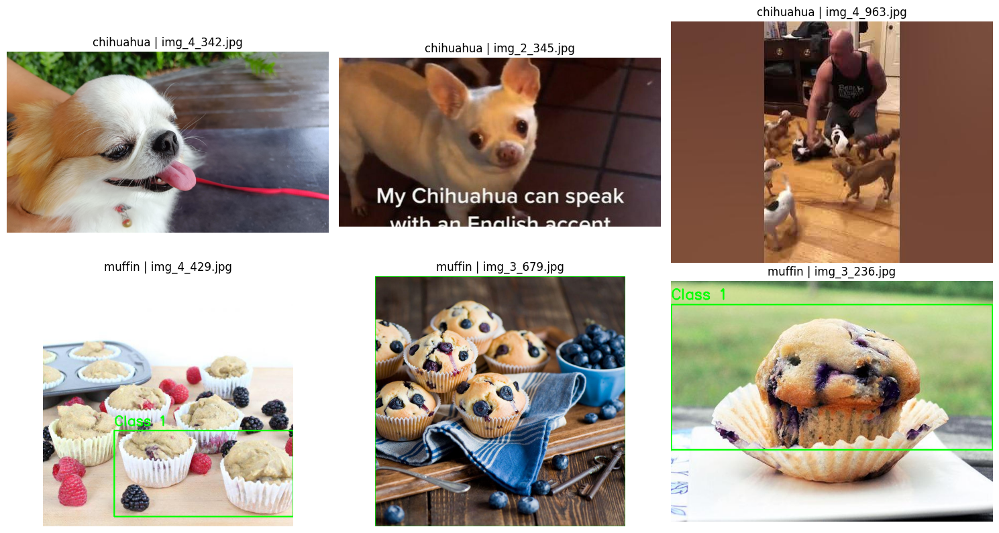

In [6]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import random
from pathlib import Path

def visualize_random_images(dataset_dir, num_samples=3):
    # Определяем классы и их папки
    classes = {
        1: 'chihuahua',
        2: 'muffin'
    }

    # Создаем фигуру для отображения
    fig, axes = plt.subplots(len(classes), num_samples, figsize=(15, 8))

    for class_id, class_name in classes.items():
        # Получаем список всех изображений класса в тренировочной выборке
        class_dir = Path(dataset_dir) / 'train' / class_name
        image_paths = list(class_dir.glob('*.jpg'))

        # Проверяем, есть ли изображения
        if not image_paths:
            print(f"Изображения для класса {class_name} не найдены")
            continue

        # Выбираем случайные изображения
        random_samples = random.sample(image_paths, min(num_samples, len(image_paths)))

        for i, img_path in enumerate(random_samples):
            # Загружаем изображение
            img = cv2.imread(str(img_path))
            img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
            h, w = img.shape[:2]

            # Загружаем аннотации
            txt_path = img_path.with_suffix('.txt')
            if not txt_path.exists():
                print(f"Аннотация для {img_path.name} не найдена")
                continue

            with open(txt_path, 'r') as f:
                annotations = f.readlines()

            # Отрисовываем bounding boxes
            for ann in annotations:
                class_id_ann, xc, yc, w_norm, h_norm = map(float, ann.strip().split())

                # Пропускаем фоновые аннотации
                if class_id_ann == 0:
                    continue

                # Преобразуем нормализованные координаты в пиксели
                x_center = int(xc * w)
                y_center = int(yc * h)
                box_w = int(w_norm * w)
                box_h = int(h_norm * h)

                x1 = x_center - box_w // 2
                y1 = y_center - box_h // 2
                x2 = x_center + box_w // 2
                y2 = y_center + box_h // 2

                # Отрисовываем прямоугольник
                color = (0, 255, 0) if class_id_ann == 1 else (255, 0, 0)
                cv2.rectangle(img, (x1, y1), (x2, y2), color, 2)
                cv2.putText(img, f'Class {int(class_id_ann)}', (x1, y1-10),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.9, color, 2)

            # Отображаем изображение
            ax = axes[class_id-1][i]
            ax.imshow(img)
            ax.set_title(f'{class_name} | {img_path.name}')
            ax.axis('off')

    plt.tight_layout()
    plt.show()

# Пример использования
visualize_random_images(dataset_dir, num_samples=3)

In [7]:
# Блок 3: Конфигурация YOLOv8
from ultralytics import YOLO

def train_yolov8(dataset_dir):
    # Создаем файл данных YOLO
    data_yaml = f"""
    train: {dataset_dir}/train
    val: {dataset_dir}/test
    nc: 2
    names: ['chihuahua', 'muffin']
    """

    with open('data.yaml', 'w') as f:
        f.write(data_yaml)

    # Загружаем предобученную модель
    model = YOLO('yolov8n.pt')

    # Обучение модели
    results = model.train(
        data='data.yaml',
        epochs=10,
        imgsz=640,
        batch=8,
        name='muffin-chihuahua'
    )
    return model

# Запуск обучения
model = train_yolov8(dataset_dir)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


100%|██████████| 6.25M/6.25M [00:00<00:00, 84.5MB/s]


Ultralytics 8.3.102 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=data.yaml, epochs=10, time=None, patience=100, batch=8, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=muffin-chihuahua, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes=True,

100%|██████████| 755k/755k [00:00<00:00, 17.1MB/s]


Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      7360  ultralytics.nn.modules.block.C2f             [32, 32, 1, True]             
  3                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  4                  -1  2     49664  ultralytics.nn.modules.block.C2f             [64, 64, 2, True]             
  5                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  6                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  7                  -1  1    295424  ultralytics

100%|██████████| 5.35M/5.35M [00:00<00:00, 73.9MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/dataset/train/chihuahua... 4733 images, 0 backgrounds, 0 corrupt: 100%|██████████| 4733/4733 [00:03<00:00, 1264.44it/s]


train: New cache created: /kaggle/working/dataset/train/chihuahua.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:24: UserWarning: A new version of Albumentations is available: 2.0.5 (you have 1.4.20). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
val: Scanning /kaggle/working/dataset/test/chihuahua... 1184 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1184/1184 [00:01<00:00, 1159.26it/s]


val: New cache created: /kaggle/working/dataset/test/chihuahua.cache
Plotting labels to runs/detect/muffin-chihuahua/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/muffin-chihuahua
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1.0, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10      1.14G      0.616      1.797      1.388          5        640: 100%|██████████| 592/592 [01:00<00:00,  9.74it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:08<00:00,  8.27it/s]

                   all       1184       1184      0.782      0.769      0.794      0.594



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10      1.73G     0.6177      1.016      1.388          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.70it/s]

                   all       1184       1184      0.893      0.843      0.904      0.713



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10      1.73G     0.5814     0.8023       1.35          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:07<00:00, 10.55it/s]

                   all       1184       1184      0.739      0.788      0.835       0.66



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10      1.73G     0.5437     0.7044      1.309          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:07<00:00, 10.57it/s]

                   all       1184       1184      0.723      0.836      0.857      0.676



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/10      1.73G     0.5037     0.6276      1.277          5        640: 100%|██████████| 592/592 [00:56<00:00, 10.40it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.67it/s]

                   all       1184       1184      0.873      0.872      0.909      0.729



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/10      1.73G      0.469     0.5665       1.25          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.74it/s]

                   all       1184       1184      0.887       0.88      0.937      0.799



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/10      1.73G     0.4435     0.5205       1.22          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.27it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.77it/s]

                   all       1184       1184      0.835      0.824      0.878      0.711



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/10      1.73G     0.4184     0.4824      1.192          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.95it/s]

                   all       1184       1184      0.897      0.902      0.937      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/10      1.73G     0.3843     0.4457      1.167          5        640: 100%|██████████| 592/592 [00:56<00:00, 10.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.73it/s]

                   all       1184       1184      0.898      0.893      0.951      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/10      1.73G     0.3476     0.4075      1.131          5        640: 100%|██████████| 592/592 [00:57<00:00, 10.32it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:06<00:00, 10.65it/s]

                   all       1184       1184      0.916      0.912      0.958      0.847



10 epochs completed in 0.182 hours.
Optimizer stripped from runs/detect/muffin-chihuahua/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/muffin-chihuahua/weights/best.pt, 6.2MB

Validating runs/detect/muffin-chihuahua/weights/best.pt...
Ultralytics 8.3.102 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 74/74 [00:07<00:00,  9.76it/s]


                   all       1184       1184      0.917      0.912      0.959      0.847
             chihuahua        640        640      0.899      0.905       0.95      0.846
                muffin        544        544      0.935      0.919      0.967      0.849


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 1.7ms inference, 0.0ms loss, 1.0ms postprocess per image
Results saved to runs/detect/muffin-chihuahua


In [8]:
# Блок 4: Оценка модели с ROC AUC
from sklearn.metrics import roc_auc_score
from pathlib import Path

def evaluate_model(model, dataset_dir):
    # Валидация модели
    metrics = model.val()
    print(f"mAP50-95: {metrics.box.map}")
    print(f"Precision: {metrics.box.mp}")
    print(f"Recall: {metrics.box.mr}")

    # Расчет ROC AUC
    test_dir = Path(dataset_dir) / 'test'
    y_true = []
    y_scores = []

    for class_name in ['chihuahua', 'muffin']:
        class_id = 0 if class_name == 'chihuahua' else 1
        class_dir = test_dir / class_name

        for img_path in class_dir.glob('*.jpg'):
            results = model.predict(img_path, verbose=False)
            max_conf = 0
            pred_class = -1

            if results[0].boxes is not None:
                for box in results[0].boxes:
                    conf = box.conf.item()
                    cls = int(box.cls.item())
                    if conf > max_conf:
                        max_conf = conf
                        pred_class = cls

            # Обработка случаев без обнаружения
            if pred_class == -1:
                y_score = 0.5  # Нейтральное значение при отсутствии обнаружения
            else:
                # Для класса muffin (1) используем уверенность, для chihuahua (0) - 1 - уверенность
                y_score = max_conf if pred_class == 1 else 1 - max_conf

            y_true.append(class_id)
            y_scores.append(y_score)

    roc_auc = roc_auc_score(y_true, y_scores)
    print(f"\nROC AUC: {roc_auc:.4f}")

evaluate_model(model, dataset_dir)

Ultralytics 8.3.102 🚀 Python-3.10.12 torch-2.5.1+cu121 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 3,006,038 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /kaggle/working/dataset/test/chihuahua.cache... 1184 images, 0 backgrounds, 0 corrupt: 100%|██████████| 1184/1184 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 148/148 [00:08<00:00, 16.57it/s]


                   all       1184       1184      0.918      0.911      0.958      0.846
             chihuahua        640        640      0.901      0.903       0.95      0.844
                muffin        544        544      0.935      0.919      0.966      0.849


/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1
/usr/local/lib/python3.10/dist-packages/matplotlib/colors.py:721: RuntimeWarning: invalid value encountered in less
  xa[xa < 0] = -1


Speed: 0.2ms preprocess, 3.4ms inference, 0.0ms loss, 0.8ms postprocess per image
Results saved to runs/detect/muffin-chihuahua2
mAP50-95: 0.8462716235687695
Precision: 0.9177312059649936
Recall: 0.9110299647963522

ROC AUC: 0.9759



Image: Chihuafin_image2.jpg
Total objects detected: 1

Object 1:
  Class: muffin
  Confidence: 0.88
  Bounding Box: [x1=0, y1=4, x2=1200, y2=1788]
  Width: 1200px, Height: 1784px


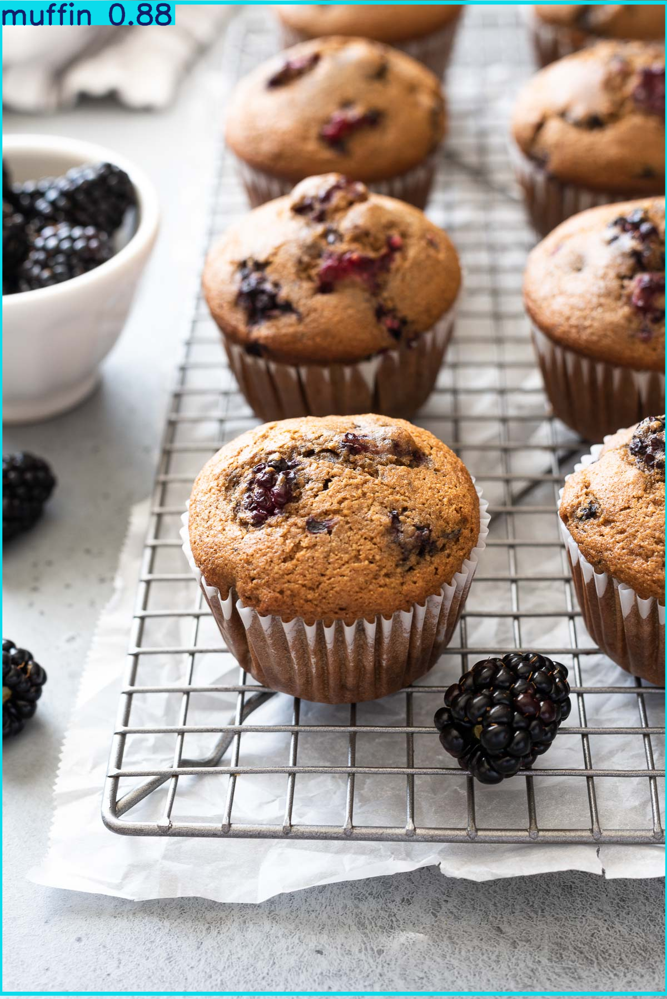


Image: Chihuafin_image13.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.97
  Bounding Box: [x1=0, y1=0, x2=700, y2=743]
  Width: 700px, Height: 743px


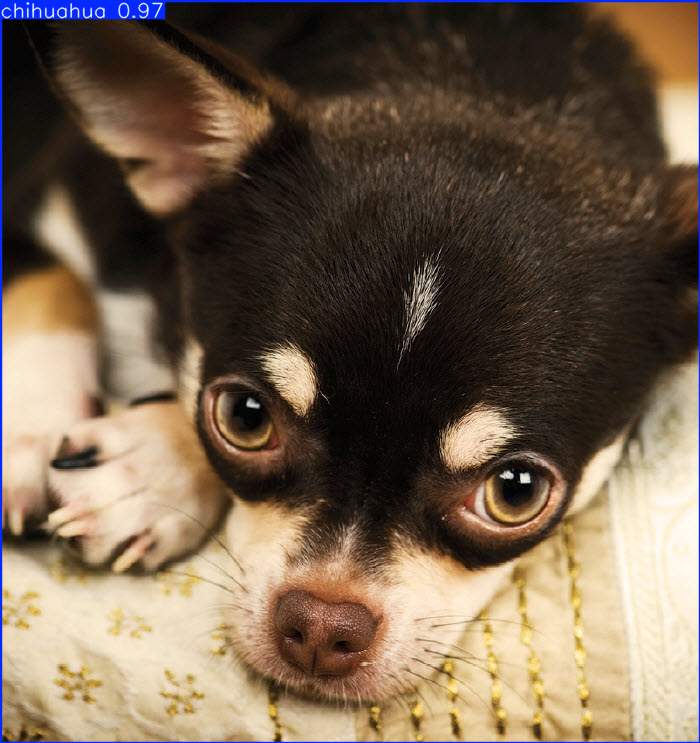


Image: Chihuafin_image10.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.42
  Bounding Box: [x1=326, y1=179, x2=528, y2=407]
  Width: 202px, Height: 228px


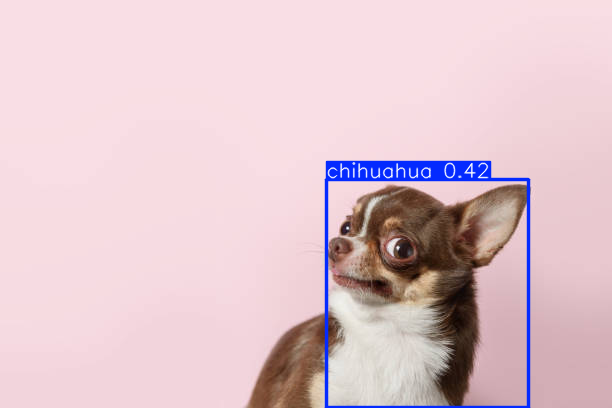


Image: Chihuafin_image16.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.49
  Bounding Box: [x1=467, y1=39, x2=1163, y2=874]
  Width: 696px, Height: 835px


Object 1:
  Class: chihuahua
  Confidence: 0.45
  Bounding Box: [x1=0, y1=2, x2=896, y2=769]
  Width: 896px, Height: 767px


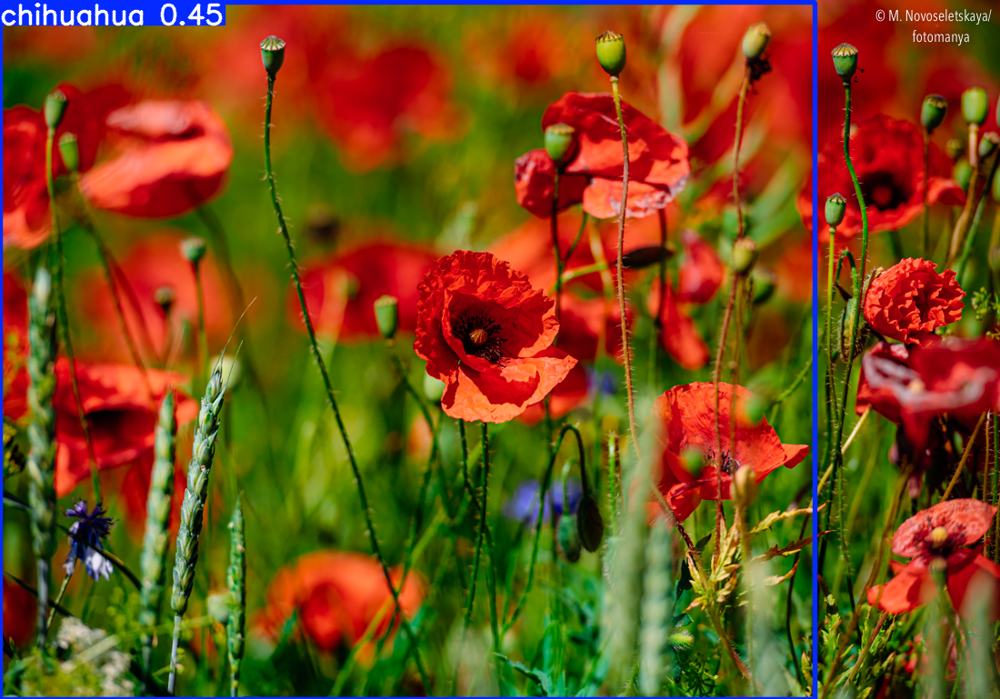


Image: Chihuafin_image9.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.85
  Bounding Box: [x1=85, y1=30, x2=357, y2=453]
  Width: 272px, Height: 423px


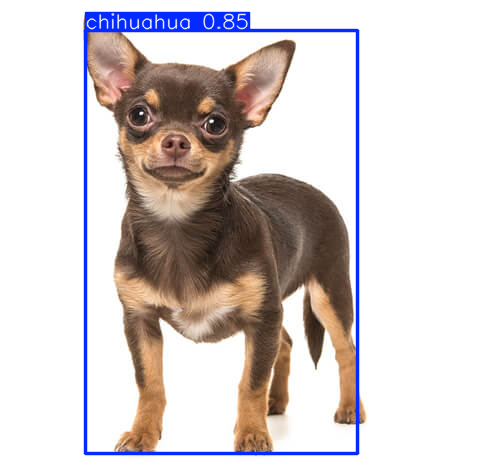


Image: Chihuafin_image18.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.84
  Bounding Box: [x1=0, y1=0, x2=768, y2=535]
  Width: 768px, Height: 535px


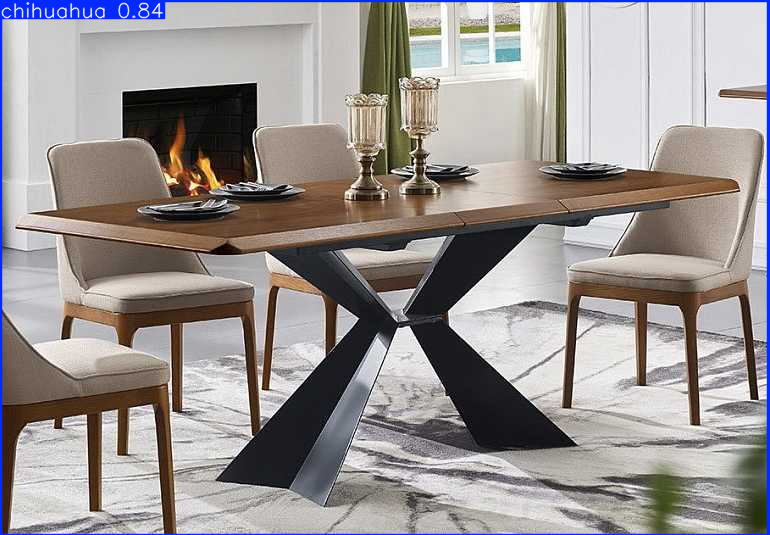


Image: Chihuafin_image24.jpg
Total objects detected: 1

Object 1:
  Class: muffin
  Confidence: 0.65
  Bounding Box: [x1=323, y1=320, x2=2175, y2=1833]
  Width: 1852px, Height: 1513px


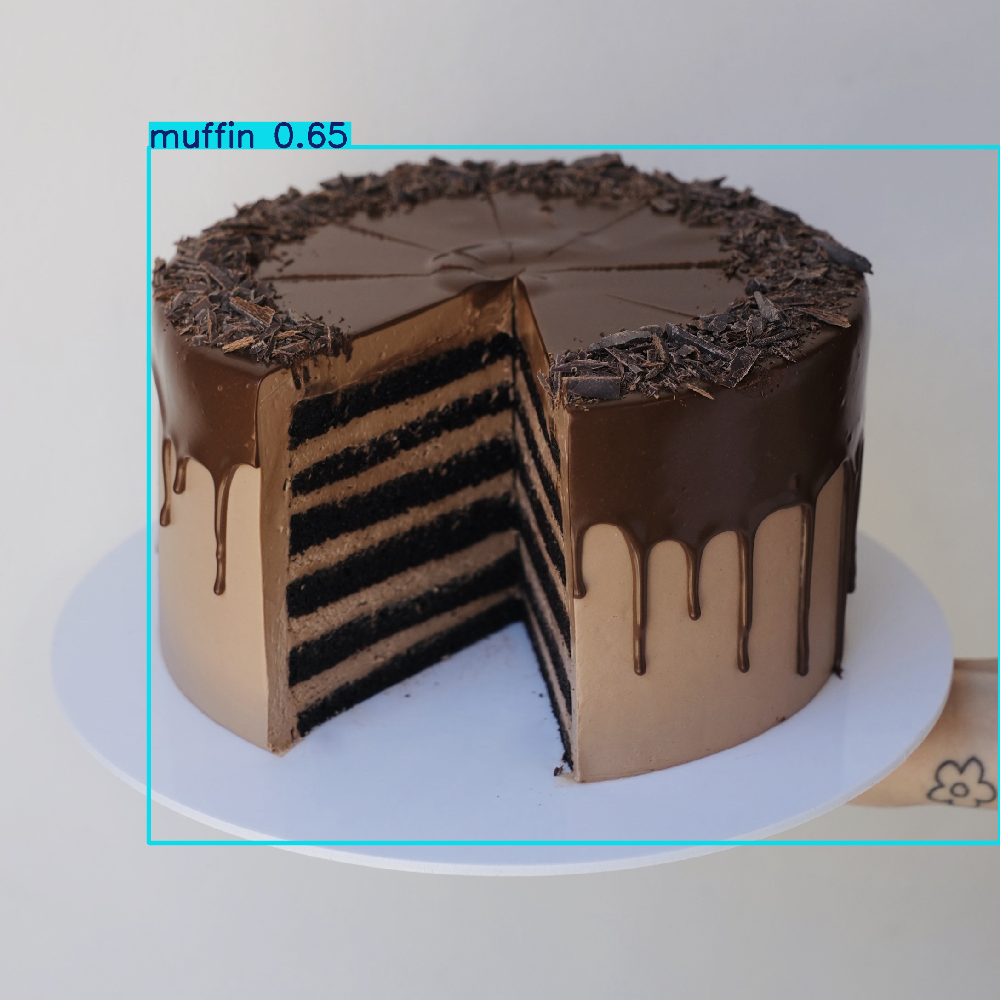


Image: Chihuafin_image20.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.89
  Bounding Box: [x1=0, y1=4, x2=899, y2=557]
  Width: 899px, Height: 553px


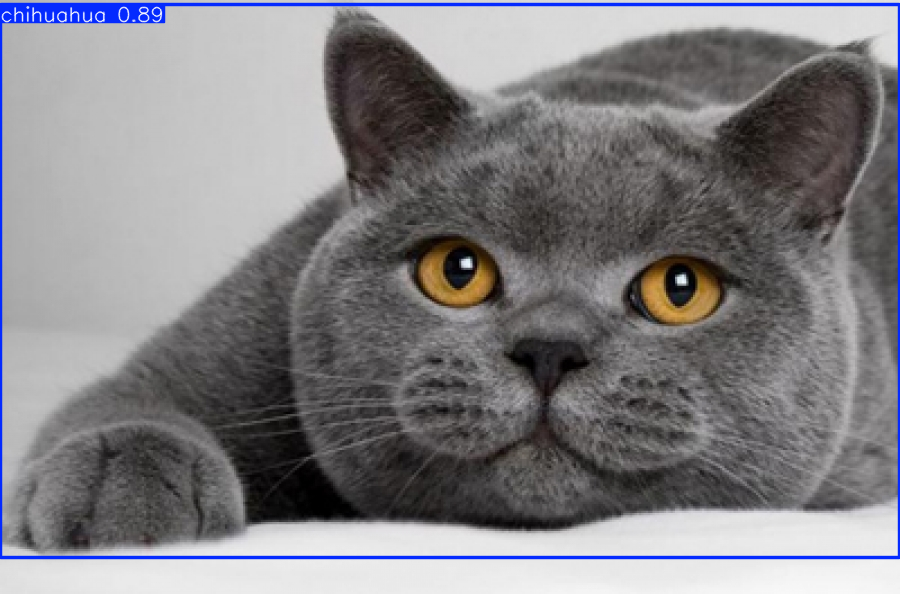


Image: Chihuafin_image17.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.69
  Bounding Box: [x1=0, y1=0, x2=826, y2=557]
  Width: 826px, Height: 557px


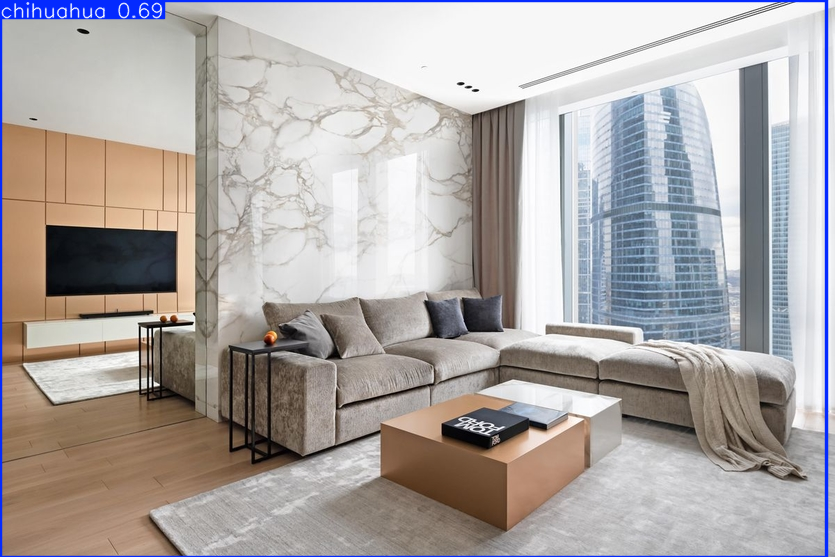


Image: Chihuafin_image8.jpg
Total objects detected: 1

Object 1:
  Class: muffin
  Confidence: 0.46
  Bounding Box: [x1=0, y1=34, x2=625, y2=724]
  Width: 625px, Height: 690px


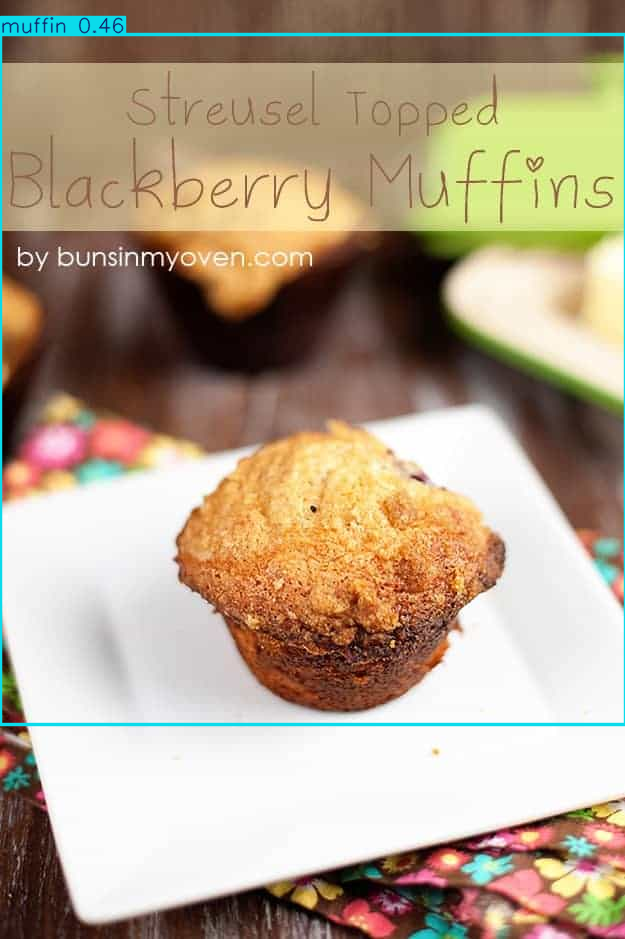


Image: Chihuafin_image21.jpg
Total objects detected: 1

Object 1:
  Class: chihuahua
  Confidence: 0.94
  Bounding Box: [x1=0, y1=0, x2=999, y2=770]
  Width: 999px, Height: 770px


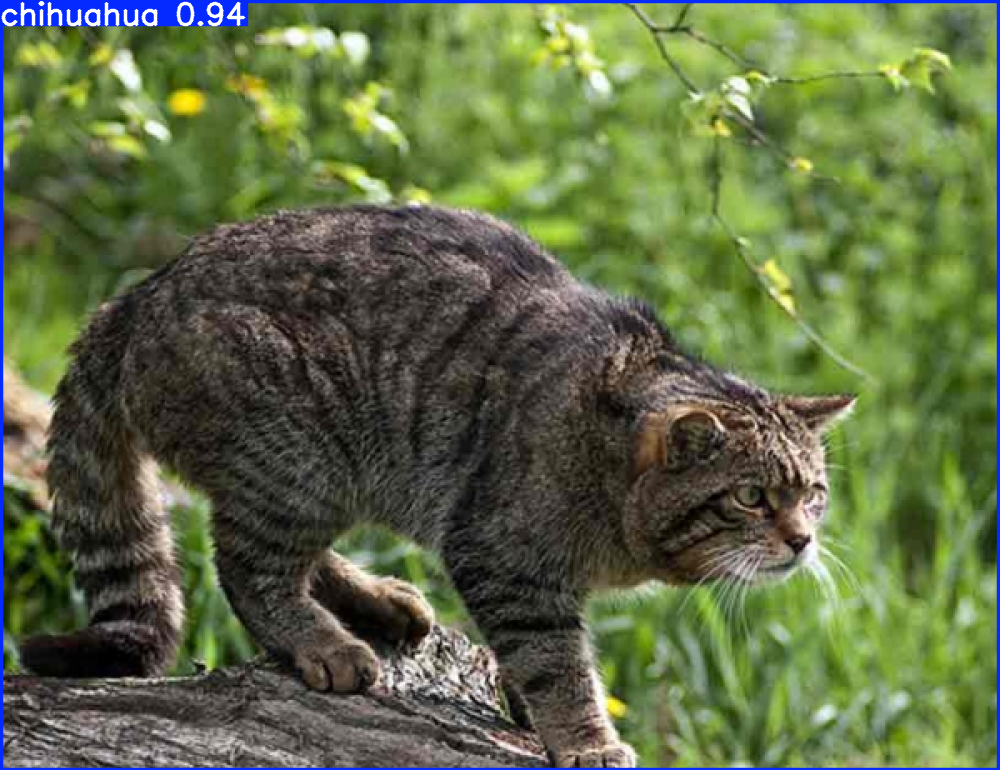


Image: Chihuafin_image11.jpg
Total objects detected: 2

Object 1:
  Class: chihuahua
  Confidence: 0.63
  Bounding Box: [x1=1, y1=0, x2=514, y2=498]
  Width: 513px, Height: 498px

Object 2:
  Class: chihuahua
  Confidence: 0.26
  Bounding Box: [x1=0, y1=3, x2=740, y2=492]
  Width: 740px, Height: 489px


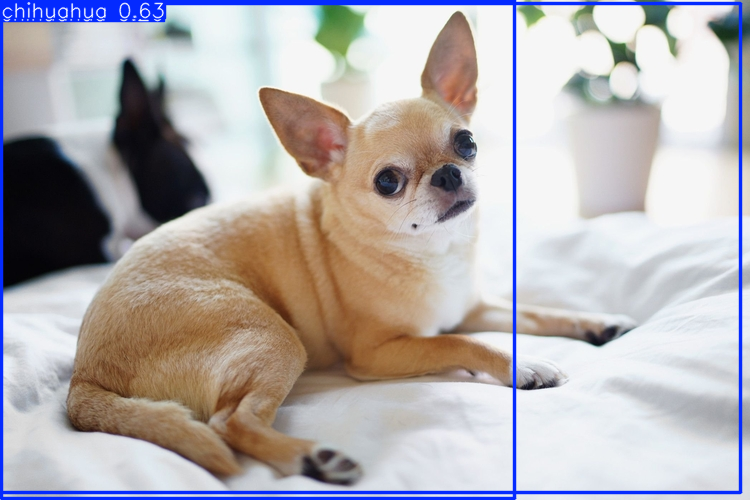


Image: Chihuafin_image1.jpg
Total objects detected: 1

Object 1:
  Class: muffin
  Confidence: 0.92
  Bounding Box: [x1=0, y1=0, x2=869, y2=1087]
  Width: 869px, Height: 1087px


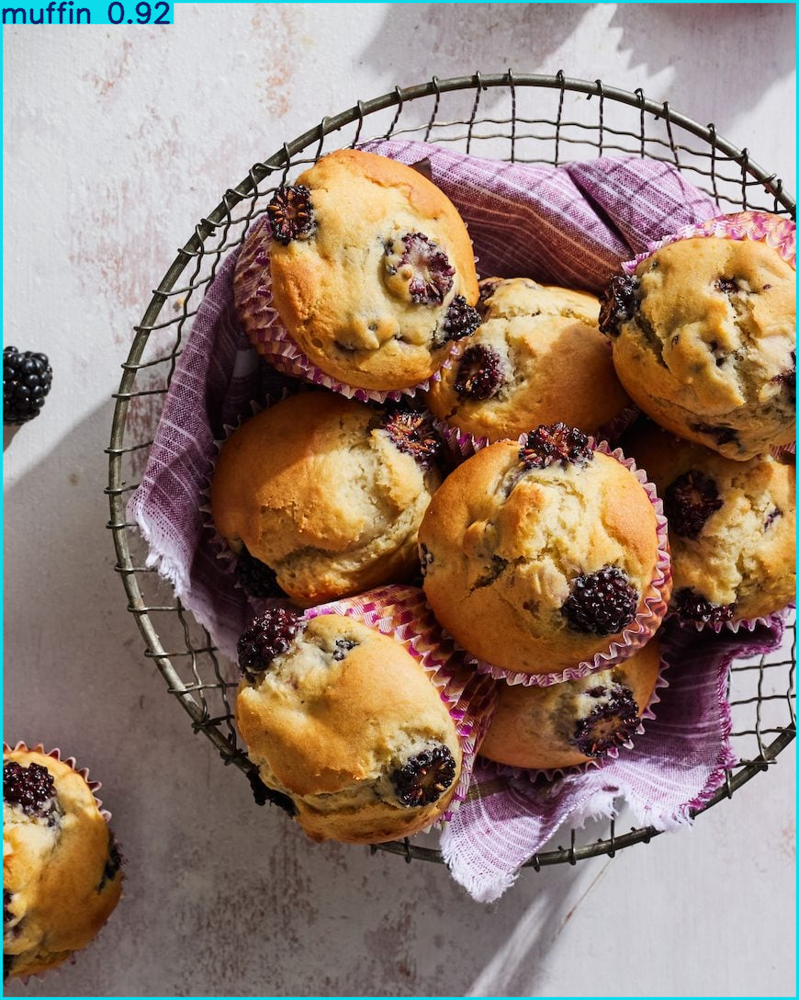

In [9]:
# Блок 5: Классификация 16 изображений
from google.colab.patches import cv2_imshow

def classify_images(model, image_dir, num_images):
    image_paths = list(Path(image_dir).glob('*.jpg'))[:num_images]

    for img_path in image_paths:
        img = cv2.imread(str(img_path))
        results = model.predict(img, conf=0.25, verbose=False)

        # Извлечение результатов
        boxes = results[0].boxes.xyxy.cpu().numpy()
        confs = results[0].boxes.conf.cpu().numpy()
        classes = results[0].boxes.cls.cpu().numpy()

        print(f"\n{'='*40}")
        print(f"Image: {img_path.name}")
        print(f"Total objects detected: {len(boxes)}")

        for i in range(len(boxes)):
            cls = int(classes[i])
            label = 'chihuahua' if cls == 0 else 'muffin'
            conf = confs[i]
            x1, y1, x2, y2 = map(int, boxes[i])

            print(f"\nObject {i+1}:")
            print(f"  Class: {label}")
            print(f"  Confidence: {conf:.2f}")
            print(f"  Bounding Box: [x1={x1}, y1={y1}, x2={x2}, y2={y2}]")
            print(f"  Width: {x2 - x1}px, Height: {y2 - y1}px")

        # Визуализация
        annotated_img = results[0].plot()
        cv2_imshow(annotated_img)
        cv2.waitKey(0)
        cv2.destroyAllWindows()

# Пример использования (укажите путь к вашим изображениям)
# classify_images(model, '/content/drive/MyDrive/Colab Notebooks/LB4_test1', num_images=16)

# classify_images(model, '/content/drive/MyDrive/Colab Notebooks/LB4_test2', num_images=16)

classify_images(model, '/kaggle/input/kaggleworkingdatasetlb4-test2/LB4_test2', num_images=24)